# ***Project2***
*Importing data*

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import json

In [5]:
# As we have only limited storage we will store only the data which is required for our analysis
i = 0
bus_newyark = []
for line in open('/content/drive/MyDrive/FOCP2/yelp_academic_dataset_business.json', 'r', encoding = 'utf8'):
#business data set
 jsonObject = json.loads(line)
 if jsonObject['city'] == 'Newark': # As for the group8 the city is Newyark we are filtering ot the data for newyark
   i = i + 1
   
   new_dict = {
                          "business_id": jsonObject["business_id"],
                          "city": jsonObject["city"],
                          "latitude": jsonObject["latitude"],
                          "longitude": jsonObject["longitude"],
                          "name": jsonObject["name"],
                          "mappevalue" : "b"+str(i) # we are giving a alise to long business_id 
      }

   bus_newyark.append(new_dict) # we have storing the business name which are in newark

In [6]:
# error which occured write code for exception handaling for handaling the JSONDecodeError: Unterminated string starting at: line 1 column 162 (char 161)
# As we have only limited storage we will store only the data which is required for our analysis
from json import JSONDecodeError 

review_bus_newyark = []
user_id_map = []
count = 1
mapp = '0'
for line in open('/content/drive/MyDrive/FOCP2/yelp_academic_dataset_review.json', 'r', encoding='utf8'):
 
  try:
    jsonObject2 = json.loads(line)
  except  JSONDecodeError:
    line = line +'"'+"}"
    jsonObject2 = json.loads(line)
    print("Exception was resolved as the file was not terminated")

  for i in bus_newyark:
   if i['business_id'] == jsonObject2['business_id']:
        
        flag = 0
        
        for j in user_id_map:
#same approach can't be used as there are a case where same user has given more that 1 review
# check if I have assigned a user id or do i need to use one          
          if j["user_id"] == jsonObject2["user_id"]:
             flag=1
             mapp=j["mappedvalue_u"]

        if flag == 0:
             mapp=str('u'+str(count))
             new_dict = {
                       "user_id": jsonObject2["user_id"],
                       "mappedvalue_u" : mapp
                     #"mappevalue"
                       }
             count=count+1 
             user_id_map.append(new_dict)  # see the list is different this is for keeping track 

        new_dict = {
                       "review_id": jsonObject2["review_id"],
                       "user_id": jsonObject2["user_id"],
                       "business_id": jsonObject2["business_id"],
                        "stars": jsonObject2["stars"],
                        "mappedvalue_u" : mapp,# for users
                        "mappevalue": i["mappevalue"] #for business 
                    }
        review_bus_newyark.append(new_dict)

In [7]:
print(jsonObject2)

{'review_id': 'RwcKOdEuLRHNJe4M9-qpqg', 'user_id': '6JehEvdoCvZPJ_XIxnzIIw', 'business_id': 'VAeEXLbEcI9Emt9KGYq9aA', 'stars': 3.0, 'useful': 10, 'funny': 3, 'cool': 7, 'text': "Located in the 'Walking District' in Nashville, it's was a bit out of the way for us, but we were on a mission to experience the proclaimed 'Greatest burger in Nashville'. \n\nThe menu includes several burgers, wursthen, and chicken sandwich options. The waitress told us that The Farm Burger is the most popular. I for one have never had a burger with an egg and the thought of it isn't very appealing. \n\nI ended up ordering the 'Pharmacy Burger', which is a less cheesier version of their 'Cheese Burger' that my husband ordered. They LOADED the mustard, but that really wasn't what I didn't like about it. It really wasn't that I disliked the burger, it just wasn't anywhere near one of the best burgers that I've had. The extra toppings at fifty cents each are pretty skimpy too. I was a fan of the wasabi aioli thou

# ***Averaging the stars***




In [8]:
temp = review_bus_newyark.copy()
temp2 = review_bus_newyark.copy()
print( len( temp ))
#issue is that it contain duplicate values  so I am resolving it 

13653


In [9]:
weights_star = []
for i in temp2:
  sum_star = int(i['stars'])
  num_star = 1
  for j in temp: 
    if ((i['review_id'] != j['review_id']) and (i['user_id'] == j['user_id']) and (i['business_id'] == j['business_id']) ) :
      sum_star = sum_star+j['stars']
      num_star = num_star+1
#we can use the business list to carry out the process. 
  new_dict = {
               "user_id": i["user_id"],
               "Aver_stars": sum_star/num_star,
               "business_id": i["business_id"],
               "mappevalue" : i["mappevalue"],
               "mappedvalue_u" : i["mappedvalue_u"]
              }
              
  weights_star.append(new_dict)

In [10]:
len(weights_star)

13653

In [11]:
#removing duplicate values 
no_duplicate = []
for i in weights_star:
    if i not in no_duplicate:
        no_duplicate.append(i)

In [12]:
len(no_duplicate)

13096




# **`Analysis 1 `**

In [13]:
# we need to get the top 5 business 
# creat a data fram to count()
import pandas as pd

temp_user_id = []
temp_user_id_mappedvalue_u = []
temp_business_id_mappevalue = []
temp_business_id = []

for i in weights_star:
  temp_user_id.append(i['user_id'])
  temp_business_id.append(i['business_id'])
  temp_business_id_mappevalue.append(i['mappevalue'])
  temp_user_id_mappedvalue_u.append(i['mappedvalue_u'])

df = pd.DataFrame(
                   { 
                       
                    "vertex_from_user_id"         : temp_user_id,
                    "temp_user_id_mappedvalue_u"  : temp_user_id_mappedvalue_u,
                    "vertex_to"                   : temp_business_id,
                    "temp_business_id_mappevalue" : temp_business_id_mappevalue,
                  
                   }
                  )

# **Bar graph for users**

In [14]:
user_review_count=dict(df['temp_user_id_mappedvalue_u'].value_counts()[0:5])

In [15]:
user_id_review_count=dict(df['vertex_from_user_id'].value_counts()[0:5])

In [16]:
print(user_review_count)
print(user_id_review_count)

{'u406': 81, 'u133': 47, 'u287': 46, 'u181': 41, 'u180': 39}
{'gF9BKX9fuTPQL-EFvSok2Q': 81, 'n2UpKhkU2N-66a1QQzrjYw': 47, 'r4_XcrRt08sADOdIT5ex3A': 46, 'LR5KLo9TkFbuLTUnQXz0xA': 41, 'cFaHx-FkCnzdfF8BccukIg': 39}


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


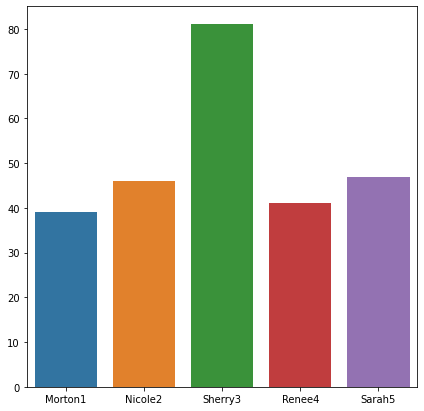

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
count=0
x_names=[]
y_count=[]
for line in open('/content/drive/MyDrive/FOCP2/yelp_academic_dataset_user.json', 'r', encoding='utf8'):
    jsonObject3 = json.loads(line)
    for i in user_id_review_count:
      if i == jsonObject3['user_id']:
        count=count+1
        temp=jsonObject3['name']+str(count)
        x_names.append(temp)
        y_count.append(user_id_review_count[i])
plt.subplots(figsize=(7,7))
sns.barplot(x_names,  y_count)
plt.show()

In [18]:
print(jsonObject3)

{'user_id': 'wL5jPrLRVCK_Pmo4lM1zpA', 'name': 'Isa', 'review_count': 2, 'yelping_since': '2020-12-19 02:32:39', 'useful': 0, 'funny': 0, 'cool': 0, 'elite': '', 'friends': 'None', 'fans': 0, 'average_stars': 5.0, 'compliment_hot': 0, 'compliment_more': 0, 'compliment_profile': 0, 'compliment_cute': 0, 'compliment_list': 0, 'compliment_note': 0, 'compliment_plain': 0, 'compliment_cool': 0, 'compliment_funny': 0, 'compliment_writer': 0, 'compliment_photos': 0}


# ***`Ploting Business on map`***

In [19]:
bus_id=dict(df['vertex_to'].value_counts()[0:5])

In [20]:
bus_id_map=dict (df['temp_business_id_mappevalue'].value_counts()[0:5])

In [21]:
lat_array=[]
lon_array=[]
y_n=[]
business_name=[]

for line in open('/content/drive/MyDrive/FOCP2/yelp_academic_dataset_business.json', 'r', encoding='utf8'):
  jsonObject = json.loads(line)
  for i in bus_id:
    if i == jsonObject['business_id']:
      lat_array.append(jsonObject['latitude'])
      lon_array.append(jsonObject['longitude'])
      y_n.append(bus_id[i])
      business_name.append(jsonObject['name'])
        

In [22]:
pip install gmplot

     |████████████████████████████████| 164 kB 14.6 MB/s 


In [23]:
import gmplot 
import seaborn as sns
import matplotlib.pyplot as plt

temp_colo=[]

gmap3 = gmplot.GoogleMapPlotter(39.675498, -75.650241, 13)
#ploting the values
for i in y_n:
  if i<=250:
    temp_colo.append('lightgrey')
  if i<300 and i>=250:
    temp_colo.append('silver')
  if i<350 and i>=300:
    temp_colo.append('darkgrey')
  if i>350 and i<400:
    temp_colo.append('maroon500')
  if i>400:
    temp_colo.append('black')



gmap3.scatter( lat_array,lon_array,label=business_name,color=temp_colo,title=y_n)

gmap3.draw( "/content/drive/MyDrive/map_fin67.html" )

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


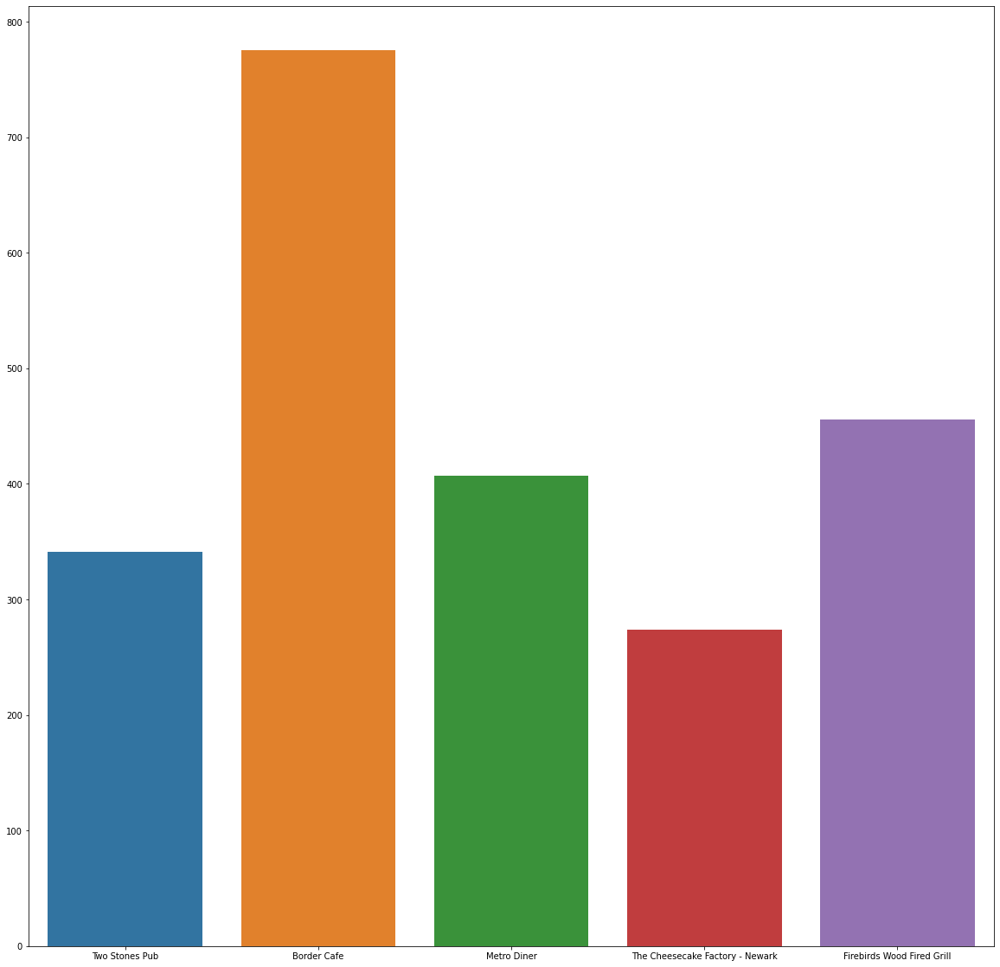

In [47]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.subplots(figsize=(20,20))
sns.barplot(business_name,y_n)
plt.show()

# ***`Connecting the graph which is disconnected`***

In [26]:
buss_list_with_review = []
for i in no_duplicate:
    if i['mappevalue'] not in no_duplicate:
        buss_list_with_review.append(i['mappevalue'])
print(len(buss_list_with_review))

13096


In [27]:
buss_list_with_review=set(buss_list_with_review)

In [28]:
buss_list_with_review=list(buss_list_with_review)

In [29]:
len(buss_list_with_review)


359

In [30]:
#Using the slide 9
dum_userid='ux'
star_temp=0 # generate the graph by giving it 0  try it 
values_list=[]
for i in bus_newyark:
  for j in buss_list_with_review:
    if i["mappevalue"] == j:
      new_dict = {
          "user_id": dum_userid,
          "Aver_stars": star_temp,
          "business_id": i["business_id"],
          "mappevalue" : i['mappevalue'],
          "mappedvalue_u" : 'ux',
                    }
      values_list.append(new_dict)

In [31]:
#puting the key value pair in the review dictionary 
no_duplicate_copy = no_duplicate.copy()#keeping the orignal list safe so that it might be usefull in future
no_duplicate_copy.extend(values_list) #combining the 2 strings inorder to make a comple graph 

In [32]:
buss_list_with_review = []
for i in no_duplicate:
    if i['mappevalue'] not in buss_list_with_review:
        buss_list_with_review.append(i['mappevalue'])

# ***Networkx ***

After the analysis I came to know that though there are a few business in newyark but they haven't recived any review . So they won't be included in the graph 

In [33]:
#understing the newtwork_summary
# we will a data fram for easy access of our data
import pandas as pd
vertex_from=[]
vertex_to=[]
edge_color=[]
typ=[]
size=[]
weightx=[]

for i in no_duplicate_copy:
  vertex_from.append(i['mappevalue']) #business_id which we genrated 
  vertex_to.append(i['mappedvalue_u']) #user_id which we genrated 
  if i['mappedvalue_u']=='ux':
    edge_color.append('green')
  else:
    edge_color.append('red')
    
  weightx.append(i['Aver_stars'])
# creating the dataframe
data_fram = pd.DataFrame(
                   { "vertex_from": vertex_from,
                    "vertex_to" : vertex_to,
                   "edge_color" : edge_color,
                    'weightx' : weightx
                   }
)


In [34]:
data_fram.head()

,vertex_from,vertex_to,edge_color,weightx
0,b5,u1,red,5.0
1,b16,u2,red,5.0
2,b13,u3,red,5.0
3,b16,u4,red,1.0
4,b19,u5,red,3.0


In [35]:
data_fram['vertex_to'].value_counts()
# see there are duplicate values u180 something fishy 

ux       359
u133      39
u180      36
u181      33
u406      30
        ... 
u3711      1
u3710      1
u3709      1
u3707      1
u4519      1
Name: vertex_to, Length: 9037, dtype: int64

In [36]:
data_fram

,vertex_from,vertex_to,edge_color,weightx
0,b5,u1,red,5.0
1,b16,u2,red,5.0
2,b13,u3,red,5.0
3,b16,u4,red,1.0
4,b19,u5,red,3.0
...,...,...,...,...
13450,b355,ux,green,0.0
13451,b356,ux,green,0.0
13452,b357,ux,green,0.0
13453,b358,ux,green,0.0


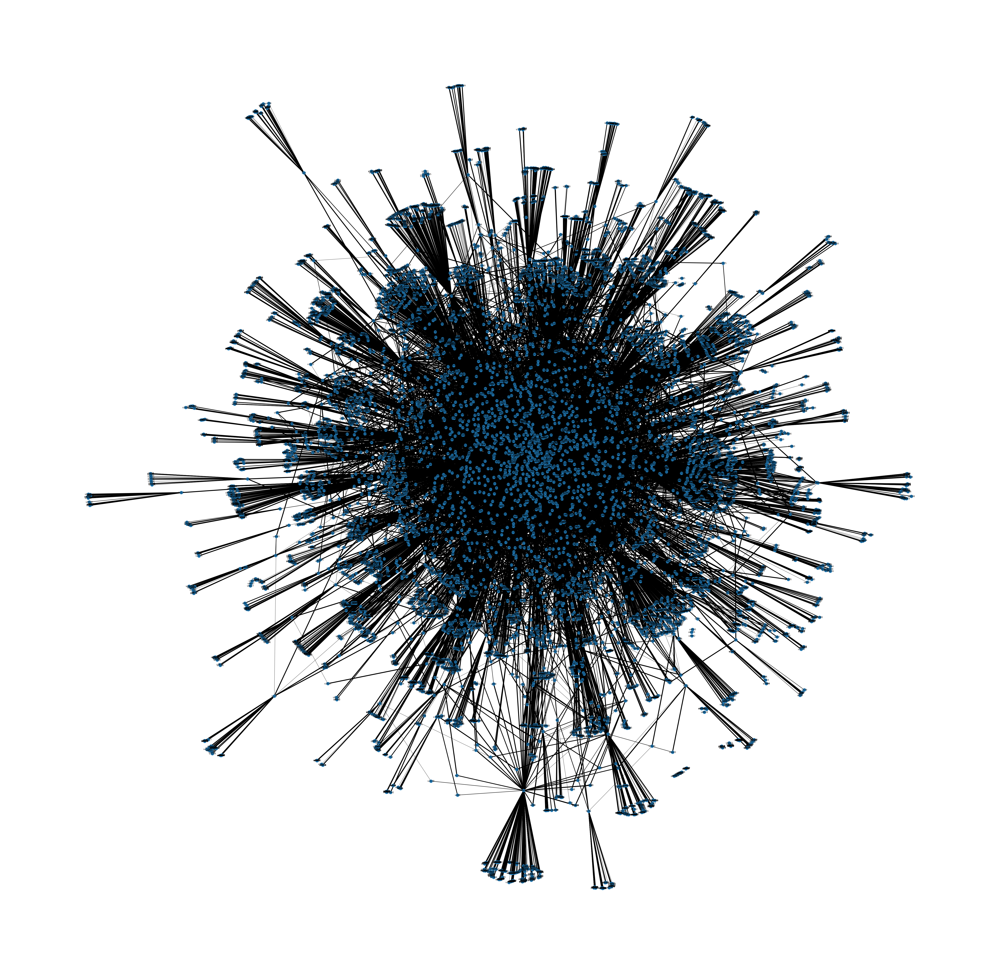

In [37]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
G= nx.Graph()

fig, ax = plt.subplots(figsize=(100,100))

G = nx.from_pandas_edgelist(data_fram, 'vertex_from', 'vertex_to', create_using=nx.Graph())

nx.draw(G,with_labels=True,width=weightx)



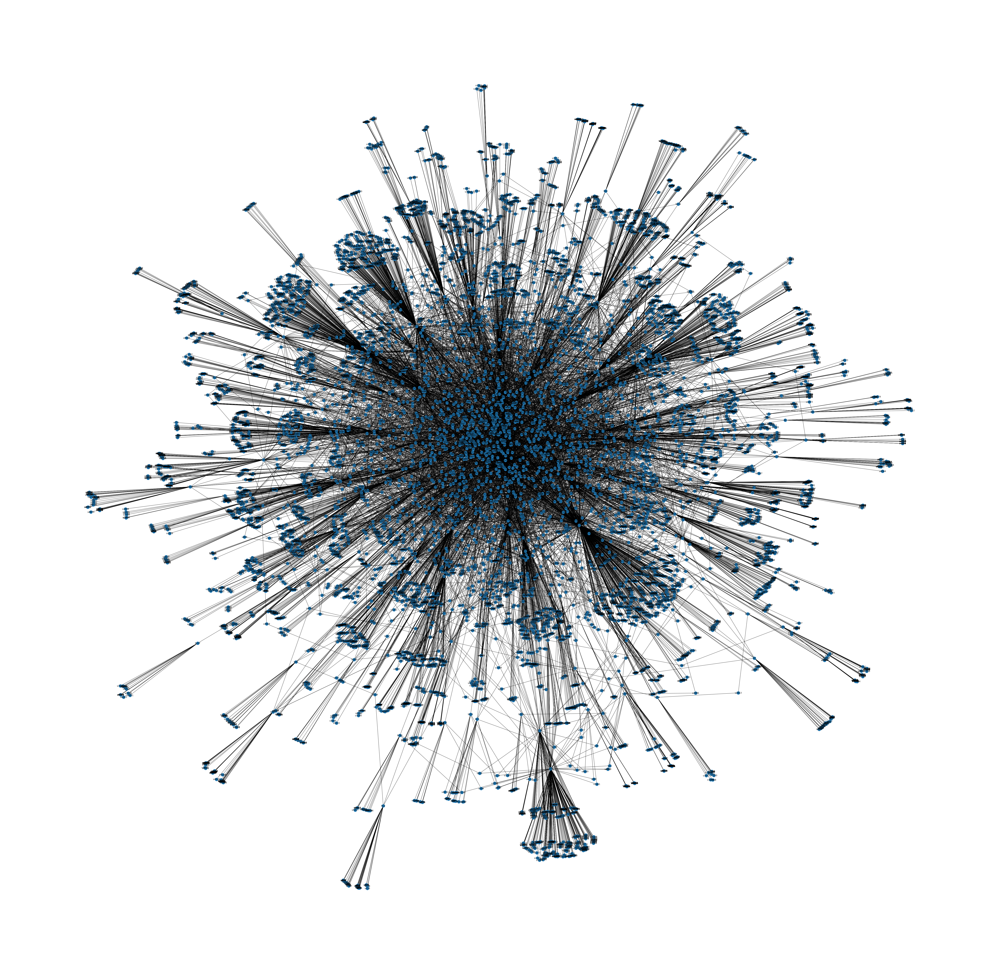

In [38]:

plt.subplots(figsize=(100,100))
nx.draw(G,with_labels=True)

Basic charecterstics of the graph 

In [39]:
#basic characteristics of the Graph.
import numpy as np 

deg=[]
sum=0
k=G.degree()
for i in k:
  deg.append(i[1])
  sum=sum+i[1]

st_dev = np.std(deg)
print("Number of nodes present in the graph ",nx.number_of_nodes(G))
print("Number of edges present in the graph ",nx.number_of_edges(G))
print("Density of the graph is ", nx.density(G))
print("Number of connected component for the graph",nx.number_connected_components(G))
print("Minimum Degree of the graph is ",min(deg))

print("Average Degree of the graph is ",sum/len(deg))
print("Standard Deviation of the graph is",np.std(deg))

Number of nodes present in the graph  9396
Number of edges present in the graph  13455
Density of the graph is  0.0003048413703384249
Number of connected component for the graph 1
Minimum Degree of the graph is  1
Average Degree of the graph is  2.863984674329502
Standard Deviation of the graph is 15.08150896869607


In [40]:
print(i[1])

359


In [41]:
G.degree()

DegreeView({'b5': 106, 'u1': 1, 'b16': 70, 'u2': 1, 'b13': 130, 'u3': 5, 'u4': 1, 'b19': 70, 'u5': 3, 'b8': 37, 'u6': 1, 'b22': 25, 'u7': 6, 'b6': 12, 'u8': 1, 'u9': 3, 'u10': 3, 'b21': 22, 'u11': 2, 'u12': 8, 'u13': 2, 'b24': 15, 'u14': 1, 'b12': 37, 'u15': 1, 'u16': 1, 'b9': 65, 'u17': 3, 'u18': 2, 'u19': 1, 'b37': 13, 'u20': 5, 'u21': 1, 'b10': 29, 'u22': 1, 'u23': 2, 'u24': 4, 'u25': 1, 'u26': 2, 'u27': 1, 'u28': 1, 'b17': 18, 'u29': 5, 'u30': 22, 'u31': 4, 'u32': 2, 'u33': 1, 'u34': 1, 'u35': 3, 'u36': 6, 'u37': 1, 'u38': 1, 'u39': 9, 'b20': 24, 'u40': 1, 'u41': 1, 'u42': 4, 'u43': 1, 'u44': 2, 'u45': 1, 'u46': 1, 'u47': 3, 'u48': 1, 'u49': 1, 'u50': 1, 'u51': 4, 'u52': 1, 'u53': 1, 'u54': 1, 'u55': 8, 'u56': 1, 'u57': 1, 'u58': 3, 'u59': 1, 'u60': 1, 'u61': 1, 'u62': 1, 'u63': 1, 'u64': 2, 'u65': 2, 'u66': 1, 'u67': 1, 'b2': 14, 'u68': 1, 'u69': 2, 'u70': 3, 'u71': 1, 'u72': 5, 'u73': 1, 'u74': 2, 'b35': 32, 'u75': 1, 'u76': 1, 'u77': 1, 'u78': 1, 'u79': 1, 'u80': 1, 'u81': 1, 'u

# **Analysis 2:**

In [42]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
G= nx.Graph()
for i in no_duplicate_copy:
  G.add_edge(i['mappedvalue_u'],i['mappevalue'],capacity=i["Aver_stars"])

In [43]:
from networkx.algorithms.flow import edmonds_karp

max_ed_1 = 'x'
max_ed_2 = 'x'
values = -1
for i in no_duplicate_copy:
  R = edmonds_karp(G,i['mappedvalue_u'],i['mappevalue'])
  max = nx.maximum_flow(R,i['mappedvalue_u'],i['mappevalue'])
  valuesx=max[0]
  if values < valuesx:
    values=valuesx
    max_ed_1 = i['mappedvalue_u']
    max_ed_2 = i['mappevalue']

In [46]:
print("We got the max flow for the pair",max_ed_1,max_ed_2,"with the value",values)

We got the max flow for the pair u180 b13 with the value 131.0
